In [18]:
!pip install bar_chart_race

In [1]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


Task 1: This is an open ended problem. Apply Exploratory Data Analysis (Univariate and Bivariate) on the dataset available above.

import necessary libraries

In [26]:
import pandas as pd
import bar_chart_race as bcr
import plotly.express as px

Load The Dataset

In [27]:
df = pd.read_csv('dataset.csv')
df.head()

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,NaN,198968248,POINT (-81.80023 24.5545),NaN,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,NaN,5204412,POINT (-114.57245 35.16815),NaN,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


# Displaying the Shape of the DataFrame

In [28]:
df.shape

(112634, 17)

# Displaying the Column Names of the DataFrame

In [29]:
df.columns

Index(['VIN (1-10)', 'County', 'City', 'State', 'Postal Code', 'Model Year',
       'Make', 'Model', 'Electric Vehicle Type',
       'Clean Alternative Fuel Vehicle (CAFV) Eligibility', 'Electric Range',
       'Base MSRP', 'Legislative District', 'DOL Vehicle ID',
       'Vehicle Location', 'Electric Utility', '2020 Census Tract'],
      dtype='object')

# Displaying DataFrame Information

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112634 entries, 0 to 112633
Data columns (total 17 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   VIN (1-10)                                         112634 non-null  object 
 1   County                                             112634 non-null  object 
 2   City                                               112634 non-null  object 
 3   State                                              112634 non-null  object 
 4   Postal Code                                        112634 non-null  int64  
 5   Model Year                                         112634 non-null  int64  
 6   Make                                               112634 non-null  object 
 7   Model                                              112614 non-null  object 
 8   Electric Vehicle Type                              112634 non-null  object

# Replacing Spaces with Underscores in Column Names

In [31]:
df.columns = df.columns.str.replace(' ', '_')
df.columns

Index(['VIN_(1-10)', 'County', 'City', 'State', 'Postal_Code', 'Model_Year',
       'Make', 'Model', 'Electric_Vehicle_Type',
       'Clean_Alternative_Fuel_Vehicle_(CAFV)_Eligibility', 'Electric_Range',
       'Base_MSRP', 'Legislative_District', 'DOL_Vehicle_ID',
       'Vehicle_Location', 'Electric_Utility', '2020_Census_Tract'],
      dtype='object')

# Renaming a Column for Better Clarity

In [32]:
df.rename(columns={'Clean_Alternative_Fuel_Vehicle_(CAFV)_Eligibility':'CAFV_Eligibility'}, inplace=True)
df.columns

Index(['VIN_(1-10)', 'County', 'City', 'State', 'Postal_Code', 'Model_Year',
       'Make', 'Model', 'Electric_Vehicle_Type', 'CAFV_Eligibility',
       'Electric_Range', 'Base_MSRP', 'Legislative_District', 'DOL_Vehicle_ID',
       'Vehicle_Location', 'Electric_Utility', '2020_Census_Tract'],
      dtype='object')

# Checking for Missing Values in the DataFrame

In [16]:
df.isnull().sum()

VIN_(1-10)                 0
County                     0
City                       0
State                      0
Postal_Code                0
Model_Year                 0
Make                       0
Model                     20
Electric_Vehicle_Type      0
CAFV_Eligibility           0
Electric_Range             0
Base_MSRP                  0
Legislative_District     286
DOL_Vehicle_ID             0
Vehicle_Location          24
Electric_Utility         443
2020_Census_Tract          0
dtype: int64

Bivariate Analysis

# Creating a Scatter Plot for Car Make vs County

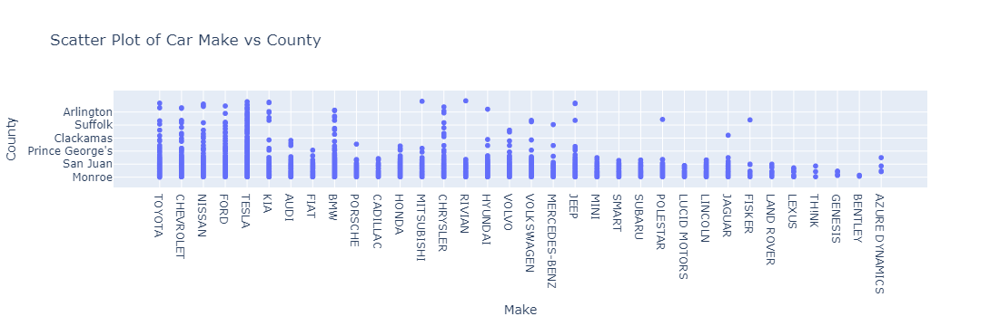

In [17]:
fig = px.scatter(df, x='Make', y='County', title="Scatter Plot of Car Make vs County")
fig.show()

# Creating a Box Plot for DOL Vehicle ID by Car Model

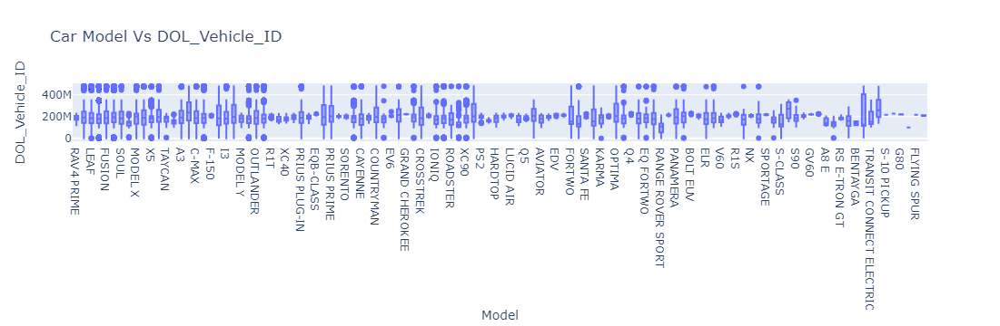

In [19]:
fig = px.box(df, x='Model', y='DOL_Vehicle_ID', title="Car Model Vs DOL_Vehicle_ID ")
fig.show()

# Creating a Pie Chart for Electric Range by Car Model

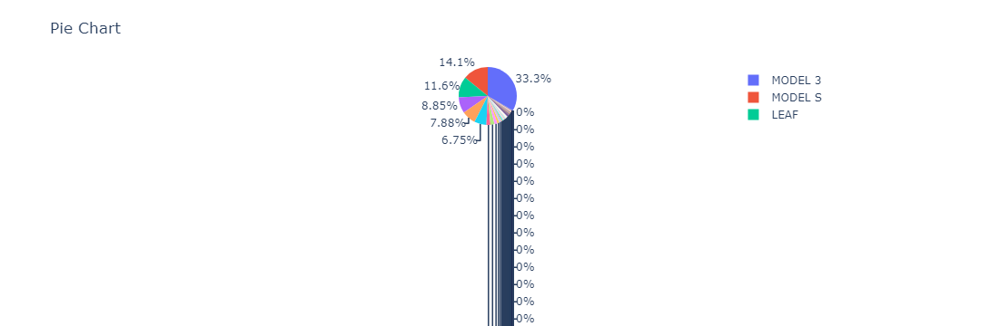

In [33]:
fig = px.pie(df, names='Model', values='Electric_Range', title="Pie Chart",)
fig.show()

Univariate Analysis

# Creating a Box Plot for Car Models

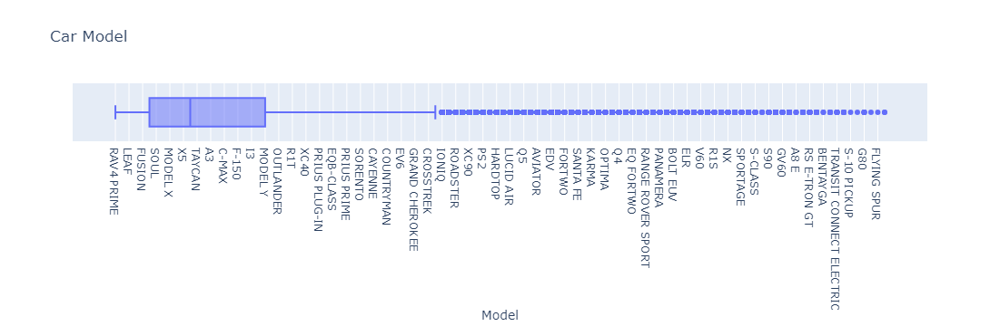

In [20]:
fig = px.box(df, x='Model', title="Car Model")
fig.show()

Task 2: Create a Choropleth using plotly.express to display the number of EV vehicles based on location

# Aggregating Electric Vehicle Counts by State

In [21]:
ev_count_by_state = df.groupby('State').size().reset_index(name='Number_of_EV_Vehicles')
ev_count_by_state

,State,Number_of_EV_Vehicles
0,AK,1
1,AL,1
2,AR,4
3,AZ,6
4,CA,76
5,CO,9
6,CT,6
7,DC,6
8,DE,1
9,FL,6


# Creating an Animated Choropleth Map of Electric Vehicle Counts by State

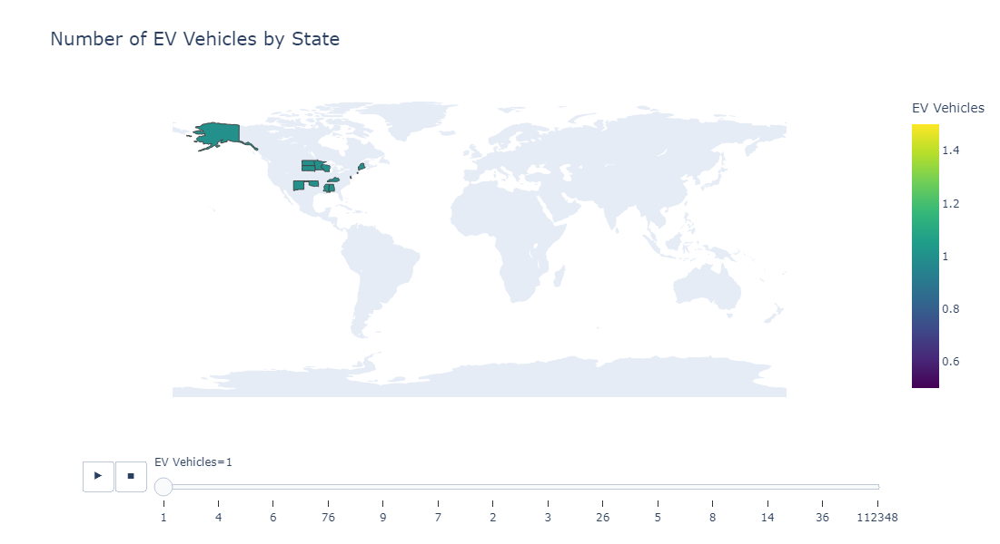

In [39]:
fig = px.choropleth(ev_count_by_state,
                    locations='State',
                    locationmode="USA-states",
                    color='Number_of_EV_Vehicles',
                    animation_frame="Number_of_EV_Vehicles",
                    scope="world",
                    color_continuous_scale="viridis",
                    labels={'Number_of_EV_Vehicles': 'EV Vehicles'},
                    title='Number of EV Vehicles by State')

fig.update_layout(
    title_font=dict(size=20),
    geo=dict(showframe=False, showcoastlines=False),
    width=1000,
    height=600
)

# Display the animated plot
fig.show()

Task 3: Create a Racing Bar Plot to display the animation of EV Make and its count each year.

# Grouping Electric Vehicles by Make and Model Year

In [23]:
ev_make_by_year = df.groupby(['Make', 'Model_Year']).size().reset_index(name='Number_of_Vehicles')

# Display the resulting DataFrame for verification
print(ev_make_by_year)

      Make  Model_Year  Number_of_Vehicles
0     AUDI        2016                 214
1     AUDI        2017                 187
2     AUDI        2018                 174
3     AUDI        2019                 392
4     AUDI        2020                 224
..     ...         ...                 ...
204  VOLVO        2019                 190
205  VOLVO        2020                 162
206  VOLVO        2021                 580
207  VOLVO        2022                 882
208  VOLVO        2023                  21

[209 rows x 3 columns]


# Create the animated racing bar plot with annotations

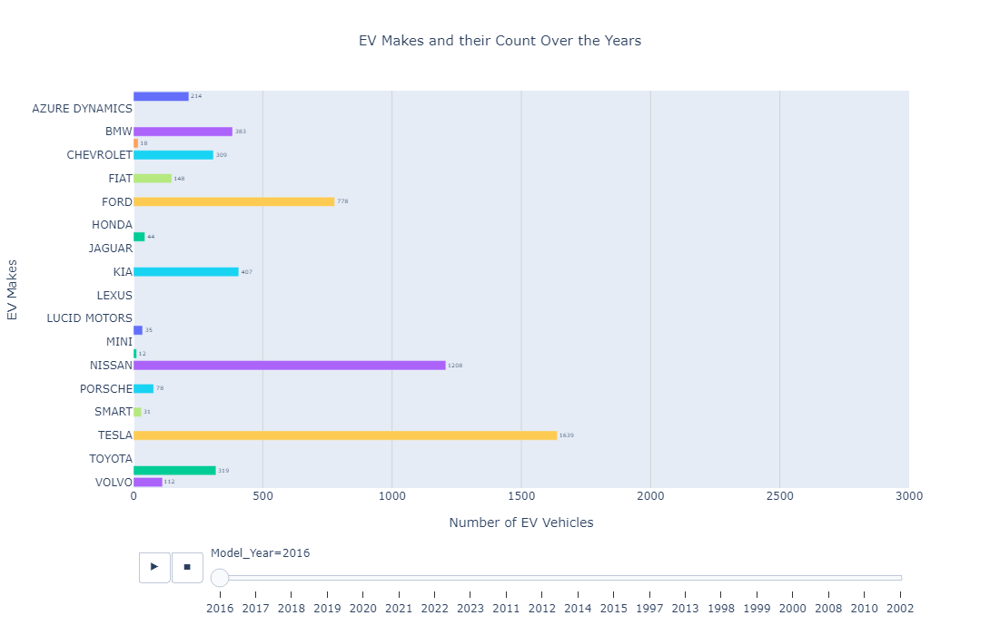

In [25]:
fig = px.bar(ev_make_by_year,
             y='Make',  
             x='Number_of_Vehicles',  
             color='Make',  
             animation_frame='Model_Year',  
             orientation='h',  
             title='EV Makes and their Count Over the Years',
             labels={'Number_of_Vehicles': 'Number of EV Vehicles'},
             range_x=[0, 3000]
            )


fig.update_traces(texttemplate='%{x}',  
                  textposition='outside',  
                  textfont_size=20)  


fig.update_layout(
    xaxis=dict(showgrid=True, gridcolor='LightGray'), 
    yaxis_title='EV Makes',
    xaxis_title='Number of EV Vehicles',
    showlegend=False,  
    title_x=0.5,  
    title_font=dict(size=15),  
    margin=dict(l=100, r=100, t=100, b=100),  
    width=900,  
    height=700  
)

# Show the plot
fig.show()
